# Data Cleaning, Processing and Consolidation

### Goals: 
- Identify and handle missing or outlier values.
- Explore the data and document findings.

### Steps:
- #### Data Quality:
1. Convert `data` to datetime and ensure temporal sorting.
2. Run profilling to hava an overall vision of the data.
3. Treat missing `avg_preco_compra` with regression inputation.
4. Fill `unidade_medida` with `R$/litro` (contant value).
5. Solve inconsistency of `id_municipio` and `id_municipio_nome`.
- #### Outliers:
6. Handle outliers in `avg_preco_compra` using Winsorization (high correlation).
7. Save complete treated data.
- #### Prepare data to EDA:
8. Save to file `sigla_uf`,`sigla_uf_nome` and remove `sigla_uf_nome` from data.
9. Save to file `id_municipio`,`id_municipio_nome` and remove `id_municipio_nome` from data.
10. Remove `unidade_medida` from data, since it is contant.

## Setup
### Required Packages

In [2]:
import pandas as pd
import matplotlib.pyplot as plt
from ydata_profiling import ProfileReport
from scipy.stats.mstats import winsorize
import plotly.express as px
import seaborn as sns


### Import Data from Parquet

In [3]:
data = pd.read_parquet('./../data/01_bronze/oil_and_gas_dataset.parquet')
data

,bandeira_revenda_cat,sigla_uf,sigla_uf_nome,id_municipio,id_municipio_nome,produto,unidade_medida,n_estabelecimentos,avg_preco_compra,avg_preco_venda,data
0,White Label,BA,Bahia,2917607,Jaguaquara,Gasolina,R$/litro,5,1.723251,2.030526,2004-05-01
1,Blue Label,SP,São Paulo,3550308,São Paulo,Diesel,R$/litro,33,1.225628,1.397636,2004-05-01
2,Green Label,SP,São Paulo,3550308,São Paulo,Diesel,R$/litro,128,1.224991,1.415282,2004-05-01
3,Green Label,SP,São Paulo,3505708,Barueri,Etanol,R$/litro,5,0.619567,0.856467,2004-05-01
4,White Label,SP,São Paulo,3513009,Cotia,Etanol,R$/litro,21,0.604228,0.804345,2004-05-01
...,...,...,...,...,...,...,...,...,...,...,...
556496,Blue Label,MA,Maranhão,2111300,São Luís,Gasolina,R$/litro,4,NaN,5.836667,2024-08-01
556497,Blue Label,PA,Pará,1506807,Santarém,Diesel,R$/litro,6,NaN,6.234545,2024-08-01
556498,Purple Label,SP,São Paulo,3526902,Limeira,Diesel,R$/litro,4,NaN,6.006000,2024-08-01
556499,Purple Label,SP,São Paulo,3518800,Guarulhos,Diesel,R$/litro,1,NaN,6.040000,2024-08-01


## 1. Convert `data` to datetime and ensure temporal sorting.
It is important to ensure that the date format is being followed and to order the values, since it is a time series.

In [4]:
data['data'] = pd.to_datetime(data['data'])
data.sort_values('data', ascending=True, inplace=True)
data

,bandeira_revenda_cat,sigla_uf,sigla_uf_nome,id_municipio,id_municipio_nome,produto,unidade_medida,n_estabelecimentos,avg_preco_compra,avg_preco_venda,data
0,White Label,BA,Bahia,2917607,Jaguaquara,Gasolina,R$/litro,5,1.723251,2.030526,2004-05-01
3501,White Label,PB,Paraíba,2507507,João Pessoa,Diesel,R$/litro,59,1.197337,1.328465,2004-05-01
3500,White Label,AL,Alagoas,2707701,Rio Largo,Etanol,R$/litro,2,0.776383,1.089750,2004-05-01
3499,White Label,PE,Pernambuco,2603405,Calumbi,Diesel,R$/litro,1,NaN,1.300000,2004-05-01
3498,Green Label,PE,Pernambuco,2613909,Serra Talhada,Etanol,R$/litro,4,0.877773,1.316875,2004-05-01
...,...,...,...,...,...,...,...,...,...,...,...
554861,Purple Label,SP,São Paulo,3530706,Mogi Guaçu,Etanol,R$/litro,1,NaN,4.040000,2024-08-01
554862,Purple Label,SP,São Paulo,3513009,Cotia,Gasolina,R$/litro,3,NaN,5.956667,2024-08-01
554863,White Label,MG,Minas Gerais,3119401,Coronel Fabriciano,Diesel,R$/litro,5,NaN,5.864545,2024-08-01
554856,Blue Label,GO,Goiás,5205109,Catalão,Etanol,R$/litro,3,NaN,4.010000,2024-08-01


## 2. Run Profilling

In [5]:
profile = ProfileReport(data, title="Profiling Report",explorative=True)
profile.to_file("./../reports/raw_data.html")
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

100%|██████████| 11/11 [00:06<00:00,  1.65it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

From profiling we do conclude:
- `unidade_medida` is contant with `R$/litro`.
- There is a high correlation between `avg_preco_venda` and `avg_preco_compra`.
    - This is a useful information with the fact that `avg_preco_compra` has missing values (almost 40.5%), since we can run a regression to input the values to `avg_preco_compra`.
- The high correlation between `id_municipio`, `sigla_uf` and `sigla_uf_nome` is totally expected, since the municipality is always in the same state, and the state name is unique to the state acronym.

- For `bandeira_revenda_cat` we have four categories: {**White Label**, **Blue Label**, **Green Label**, and **Purple Label**}.
- For `sigla_uf` we have the 27 expected for the Brazilian states (followed by 27 `sigla_uf_nome`).
- There is 690 `id_municipio`, which is the unique id for each municipality.
    - Its high cardinality makes it a candidate to be dropped.
    - We should analyze its variance to see if it contributes to explain the price difference or not.
- Although `id_municipio_nome` should be the name of the municipality of `id_municipio`, we can see that we only have `688` names. It should be investigated.
- For `produto` er have 3 products: {**Gasolina**, **Etanol**, and **Diesel**}.
- `n_estabelecimentos` is pretty skewed, with most of the values around 6.
- `data` goes from `2004-05-01` until `2024-08-01`, with almost 20 years of data.

In [6]:
profile.description_set.correlations.get("auto")

,avg_preco_compra,avg_preco_venda,bandeira_revenda_cat,id_municipio,n_estabelecimentos,produto,sigla_uf,sigla_uf_nome
avg_preco_compra,1.000000,0.987193,0.029812,-0.047846,-0.046726,0.459164,0.086685,0.086685
avg_preco_venda,0.987193,1.000000,0.133927,0.005754,-0.052171,0.342550,0.061348,0.061348
bandeira_revenda_cat,0.029812,0.133927,1.000000,0.204649,0.019064,0.016877,0.099351,0.099351
id_municipio,-0.047846,0.005754,0.204649,1.000000,0.041336,0.063141,0.999404,0.999404
n_estabelecimentos,-0.046726,-0.052171,0.019064,0.041336,1.000000,0.012380,0.019507,0.019507
produto,0.459164,0.342550,0.016877,0.063141,0.012380,1.000000,0.047365,0.047365
sigla_uf,0.086685,0.061348,0.099351,0.999404,0.019507,0.047365,1.000000,1.000000
sigla_uf_nome,0.086685,0.061348,0.099351,0.999404,0.019507,0.047365,1.000000,1.000000


In [7]:
def correlation_df_to_latex(df, caption="Matriz de Correlação"):
    def format_cell(value):
        intensity = int(round(100 * abs(value)))
        color = f"red!{intensity}!white" if value < 0 else f"green!{intensity}!white"
        return f"\\cellcolor{{{color}}}{value:.6f}"

    # LaTeX preamble
    latex = []
    latex.append("\\begin{adjustbox}{max width=\\textwidth}")
    latex.append("\\begin{tabular}{l" + "r" * len(df.columns) + "}")
    latex.append("\\toprule")
    header = " & " + " & ".join(df.columns) + " \\\\"
    latex.append(header)
    latex.append("\\midrule")

    # Rows
    for idx, row in df.iterrows():
        row_str = [idx] + [format_cell(val) for val in row]
        latex.append(" & ".join(row_str) + " \\\\")

    latex.append("\\bottomrule")
    latex.append("\\end{tabular}")
    latex.append("\\end{adjustbox}")
    return "\n".join(latex)


In [8]:
latex_code = correlation_df_to_latex(profile.description_set.correlations.get("auto"))
with open("correlation_table.tex", "w", encoding="utf-8") as f:
    f.write(latex_code)  # NÃO use repr() aqui!


### 3. Treat missing `avg_preco_compra` with regression inputation.

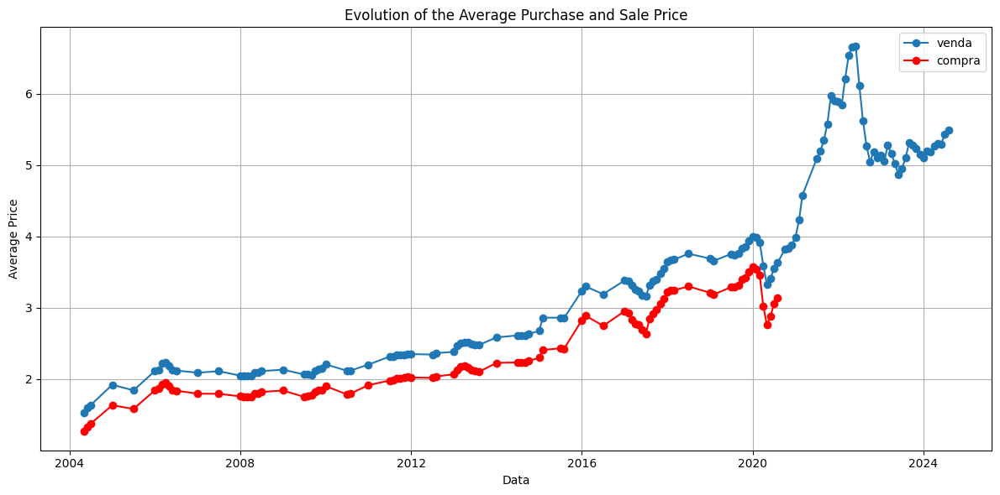

In [9]:
%matplotlib inline
# Group by date and compute average price
data_grouped = data.groupby('data')['avg_preco_venda'].mean().reset_index()
data_grouped_compra = data.groupby('data')['avg_preco_compra'].mean().reset_index()

# Plot
plt.figure(figsize=(12, 6))
plt.plot(data_grouped['data'], data_grouped['avg_preco_venda'], marker='o', label="venda")
plt.plot(data_grouped_compra['data'], data_grouped_compra['avg_preco_compra'], marker='o', color='red',label="compra")
plt.title("Evolution of the Average Purchase and Sale Price")
plt.xlabel("Data")
plt.ylabel("Average Price")
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()


Since the correlation between `avg_preco_venda` and `avg_preco_compra` is very high (0.987) we will use it to create a regression to fill the missing values of `avg_preco_compra`.

In [10]:
from sklearn.linear_model import LinearRegression
import numpy as np

# Fit model on known values
known = data[data['avg_preco_compra'].notna()]
X = known[['avg_preco_venda']]
y = known['avg_preco_compra']
model = LinearRegression().fit(X, y)

# Predict missing
missing = data[data['avg_preco_compra'].isna()]
data.loc[missing.index, 'avg_preco_compra_predicted'] = model.predict(missing[['avg_preco_venda']])

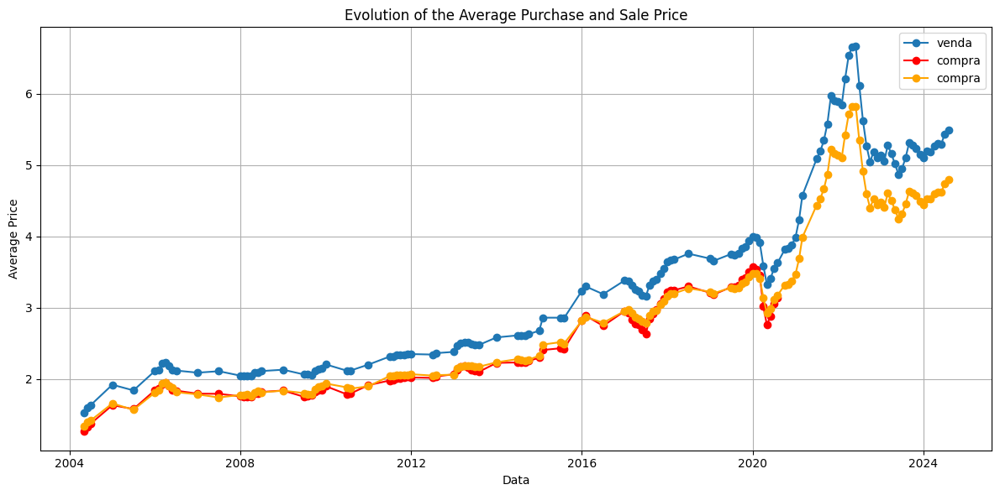

In [11]:
%matplotlib inline
# Assuming data is your DataFrame
# Convert 'data' to datetime if it's not already
data['data'] = pd.to_datetime(data['data'])

# Group by date and compute average price
data_grouped = data.groupby('data')['avg_preco_venda'].mean().reset_index()
data_grouped_compra = data.groupby('data')['avg_preco_compra'].mean().reset_index()
data_grouped_compra_predicted = data.groupby('data')['avg_preco_compra_predicted'].mean().reset_index()

# Plot
plt.figure(figsize=(12, 6))
plt.plot(data_grouped['data'], data_grouped['avg_preco_venda'], marker='o', label="venda")
plt.plot(data_grouped_compra['data'], data_grouped_compra['avg_preco_compra'], marker='o', color='red',label="compra")
plt.plot(data_grouped_compra_predicted['data'], data_grouped_compra_predicted['avg_preco_compra_predicted'], marker='o', color='orange',label="compra")

plt.title("Evolution of the Average Purchase and Sale Price")
plt.xlabel("Data")
plt.ylabel("Average Price")
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()


In [12]:
data = data.fillna(0)
data['avg_preco_compra'] = data['avg_preco_compra'] + data['avg_preco_compra_predicted']
data.drop(columns='avg_preco_compra_predicted', inplace=True, axis=1)

### 4. Fill `unidade_medida` with `R$/litro` (contant value).

In [13]:
data.loc[data['unidade_medida'].isna(),"unidade_medida"] = 'R$/litro'
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 556501 entries, 0 to 556500
Data columns (total 11 columns):
 #   Column                Non-Null Count   Dtype         
---  ------                --------------   -----         
 0   bandeira_revenda_cat  556501 non-null  object        
 1   sigla_uf              556501 non-null  object        
 2   sigla_uf_nome         556501 non-null  object        
 3   id_municipio          556501 non-null  object        
 4   id_municipio_nome     556501 non-null  object        
 5   produto               556501 non-null  object        
 6   unidade_medida        556501 non-null  object        
 7   n_estabelecimentos    556501 non-null  int64         
 8   avg_preco_compra      556501 non-null  float64       
 9   avg_preco_venda       556501 non-null  float64       
 10  data                  556501 non-null  datetime64[ns]
dtypes: datetime64[ns](1), float64(2), int64(1), object(7)
memory usage: 67.1+ MB


### 5. Solve inconsistency of `id_municipio` and `id_municipio_nome`.

In [14]:
data[['id_municipio_nome','id_municipio']].drop_duplicates().groupby('id_municipio_nome').count().sort_values('id_municipio')

,id_municipio
id_municipio_nome,
Abaetetuba,1
Passo Fundo,1
Passos,1
Pato Branco,1
Patos,1
...,...
Fortuna,1
Franca,1
Águas Lindas de Goiás,1


For `id_municipio_nome` equal to `Cascavel` and `Valença`, we do have more than one `id_municipio` allocated. It is conssitent that we only found two cases, since we do have `690` distict `id_municipio` and `688` distinct `id_municipio_nome`.

Let's analyze each of the cities to determine how to proceed.

In [15]:
data.query('id_municipio_nome == "Cascavel"')["id_municipio"].value_counts()

id_municipio
4104808    1493
2303501     104
Name: count, dtype: int64

In [16]:
data.query('id_municipio_nome == "Cascavel"')[["sigla_uf","sigla_uf_nome"]].drop_duplicates()

,sigla_uf,sigla_uf_nome
3527,PR,Paraná
27385,CE,Ceará


For the case of `Cascavel`, it is not an inconsistency, just two cities in different states with the same name (both exist). So we will keep the `id_municipio` for both as assigned.

In [17]:
data.query('id_municipio_nome == "Valença"')["id_municipio"].value_counts()

id_municipio
3306107    1188
2932903     853
Name: count, dtype: int64

In [18]:
data.query('id_municipio_nome == "Valença"')[["sigla_uf","sigla_uf_nome"]].drop_duplicates()

,sigla_uf,sigla_uf_nome
3283,BA,Bahia
5202,RJ,Rio de Janeiro


Same case here. Both Valença cities exists in these two states (Bahia and Rio de Janeiro). So again we can keep it as is, since it is consistent.

### 6. Handle outliers in `avg_preco_compra` using Winsorization (high correlation).

In [19]:
title = "Boxplot of average purchase price"
px.box(data, x = "avg_preco_compra", color="produto", title=title)

Note that we do have a huge quantity of outliers per product in the average purchase price. For a basic analysis and not resistent to outliers models, we will reduce the efect of the outliers by applying Winsorization in the `avg_preco_compra`, but we also keep the original variable to tree models.

In [20]:
# Winsorized version (apply only to column, not whole data)
data['winsor_preco_compra'] = data.groupby('produto')['avg_preco_compra'].transform(
    lambda x: winsorize(x, limits=[0.01, 0.01])
)

In [21]:
data.head()

,bandeira_revenda_cat,sigla_uf,sigla_uf_nome,id_municipio,id_municipio_nome,produto,unidade_medida,n_estabelecimentos,avg_preco_compra,avg_preco_venda,data,winsor_preco_compra
0,White Label,BA,Bahia,2917607,Jaguaquara,Gasolina,R$/litro,5,1.723251,2.030526,2004-05-01,1.760000
3501,White Label,PB,Paraíba,2507507,João Pessoa,Diesel,R$/litro,59,1.197337,1.328465,2004-05-01,1.235000
3500,White Label,AL,Alagoas,2707701,Rio Largo,Etanol,R$/litro,2,0.776383,1.089750,2004-05-01,0.803920
3499,White Label,PE,Pernambuco,2603405,Calumbi,Diesel,R$/litro,1,1.107405,1.300000,2004-05-01,1.235000
3498,Green Label,PE,Pernambuco,2613909,Serra Talhada,Etanol,R$/litro,4,0.877773,1.316875,2004-05-01,0.877773


In [22]:
title = "Boxplot of winsored average purchase price"
px.box(data, x = "winsor_preco_compra", color="produto", title=title)

In [23]:
data.to_csv('./../data/02_silver/oil_and_gas_dataset-cleaned.csv', index=False)

### 8. Save to file `sigla_uf`,`sigla_uf_nome` and remove `sigla_uf_nome` from data.

In [24]:
df_uf = data[['sigla_uf','sigla_uf_nome']].drop_duplicates().reset_index(drop=True)
data.drop(columns='sigla_uf_nome', axis=1, inplace=True)
df_uf.to_csv('./../data/03_gold/ufs.csv',index=False)
df_uf

,sigla_uf,sigla_uf_nome
0,BA,Bahia
1,PB,Paraíba
2,AL,Alagoas
3,PE,Pernambuco
4,SE,Sergipe
5,RN,Rio Grande do Norte
6,TO,Tocantins
7,AM,Amazonas
8,PA,Pará
9,MA,Maranhão


9. Save to file `id_municipio`,`id_municipio_nome` and remove `id_municipio_nome` from data.

In [25]:
df_municipio = data[['id_municipio','id_municipio_nome']].drop_duplicates().reset_index(drop=True)
data.drop(columns='id_municipio_nome', axis=1, inplace=True)
df_municipio.to_csv('./../data/03_gold/municipios.csv',index=False)
df_municipio

,id_municipio,id_municipio_nome
0,2917607,Jaguaquara
1,2507507,João Pessoa
2,2707701,Rio Largo
3,2603405,Calumbi
4,2613909,Serra Talhada
...,...,...
685,4217709,Sombrio
686,4219101,Vargeão
687,4316402,Rosário do Sul
688,2803302,Japaratuba


10. Remove `unidade_medida` from data, since it is contant.

In [26]:
data.drop(columns='unidade_medida', axis=1, inplace=True)

In [27]:
data.columns

Index(['bandeira_revenda_cat', 'sigla_uf', 'id_municipio', 'produto',
       'n_estabelecimentos', 'avg_preco_compra', 'avg_preco_venda', 'data',
       'winsor_preco_compra'],
      dtype='object')

## `n_estabelecimentos`

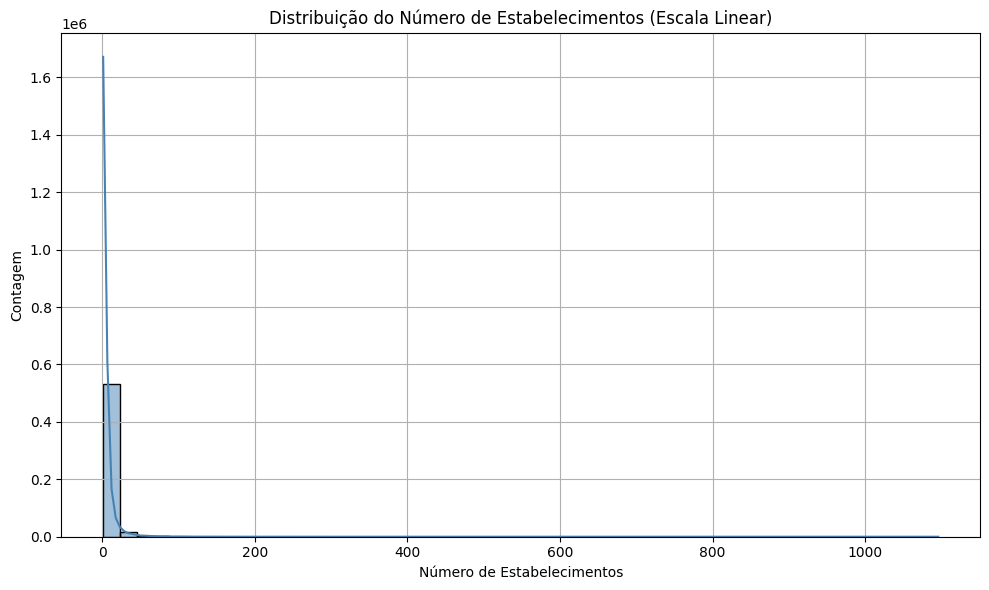

In [28]:
plt.figure(figsize=(10, 6))
sns.histplot(data=data, x="n_estabelecimentos", bins=50, kde=True, color="steelblue")
plt.title("Distribuição do Número de Estabelecimentos (Escala Linear)")
plt.xlabel("Número de Estabelecimentos")
plt.ylabel("Contagem")
plt.grid(True)
plt.tight_layout()
plt.show()


In [29]:
data["n_estabelecimentos"].describe()

count    556501.000000
mean          6.343187
std          15.529743
min           1.000000
25%           2.000000
50%           3.000000
75%           6.000000
max        1096.000000
Name: n_estabelecimentos, dtype: float64

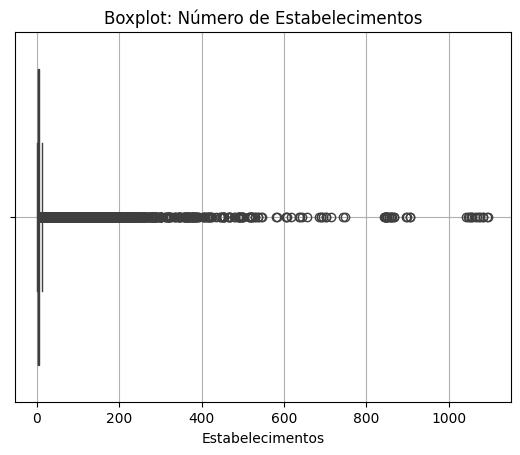

In [30]:
sns.boxplot(x=data["n_estabelecimentos"])
plt.title("Boxplot: Número de Estabelecimentos")
plt.xlabel("Estabelecimentos")
plt.grid(True)
plt.show()

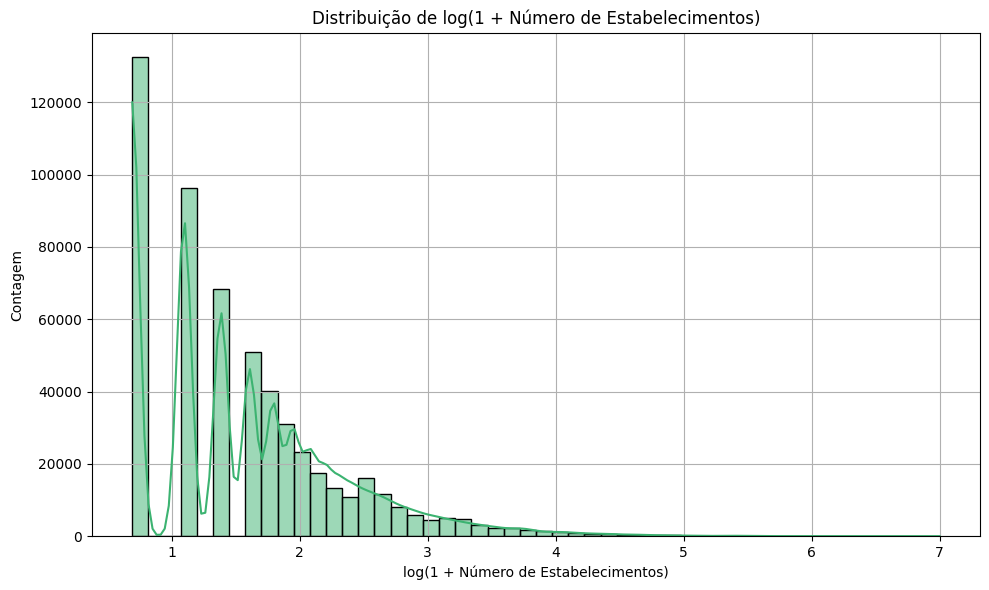

In [31]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

# Compute the transformed column
data["log_n_estabelecimentos"] = np.log1p(data["n_estabelecimentos"])

# Plot the distribution
plt.figure(figsize=(10, 6))
sns.histplot(data["log_n_estabelecimentos"], bins=50, kde=True, color="mediumseagreen")
plt.title("Distribuição de log(1 + Número de Estabelecimentos)")
plt.xlabel("log(1 + Número de Estabelecimentos)")
plt.ylabel("Contagem")
plt.grid(True)
plt.tight_layout()
plt.show()


With log(1 + `n_estabelecimentos`) the effect of the outliers is compressed and well-behaved.

We will analyze it in the correlations.

Also, lets create bins of `n_estabelecimentos`.

In [32]:
data["faixa_estabelecimentos"] = pd.cut(
    data["n_estabelecimentos"],
    bins=[0, 3, 10, 50, 200, np.inf],
    labels=["1–3", "4–10", "11–50", "51–200", "200+"]
)


In [33]:
data.faixa_estabelecimentos.value_counts()

faixa_estabelecimentos
1–3       297130
4–10      186899
11–50      66528
51–200      5503
200+         441
Name: count, dtype: int64

In [34]:
data.faixa_estabelecimentos.unique()

['4–10', '51–200', '1–3', '11–50', '200+']
Categories (5, object): ['1–3' < '4–10' < '11–50' < '51–200' < '200+']

In [35]:
title = "Boxplot of average selling price"
ordered_labels = ['1–3', '4–10',  '11–50', '51–200', '200+']
px.box(data, x = "avg_preco_venda", color="faixa_estabelecimentos", title=title, category_orders={"faixa_estabelecimentos":ordered_labels})

In [36]:
data.to_parquet('./../data/02_silver/oil_and_gas_dataset-focused_columns.parquet', index=False)